In [1]:
import pandas as pd
import numpy as np
pd.set_option("display.max_columns", None)

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

import plotly.express as px

from statsmodels.tsa.holtwinters import ExponentialSmoothing

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

import warnings
warnings.filterwarnings("ignore")

In [ ]:
data = pd.read_csv("data/BRFSS__Table_of_Prostate_Cancer_20250202.csv")

**Trend Analysis Over Time**

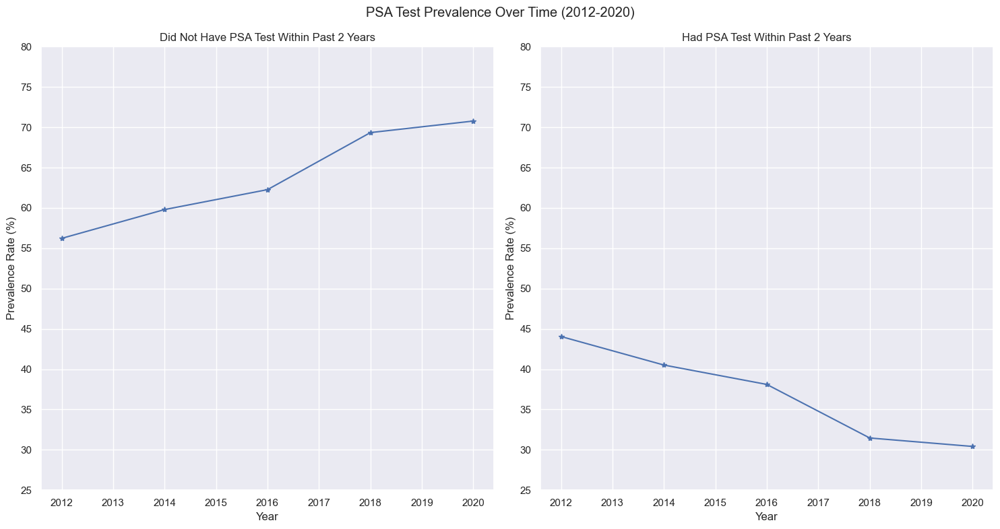

In [117]:
yes_data = data[data["Resdponse"] == "Yes"]
no_data = data[data["Response"] == "No"]

trend_yes_data = yes_data.groupby("Year")["Data_value"].mean().reset_index()
trend_no_data = no_data.groupby("Year")["Data_value"].mean().reset_index()

plt.figure(figsize = [15,8])
plt.suptitle("PSA Test Prevalence Over Time (2012-2020)")

plt.subplot(1,2,1)
plt.plot(trend_no_data["Year"], trend_no_data["Data_value"], marker = "*")
plt.title("Did Not Have PSA Test Within Past 2 Years")
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(25,81,5))

plt.subplot(1,2,2)
plt.plot(trend_yes_data["Year"], trend_yes_data["Data_value"], marker = "*")
plt.title("Had PSA Test Within Past 2 Years")
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(25,81,5))

plt.tight_layout()
plt.show()

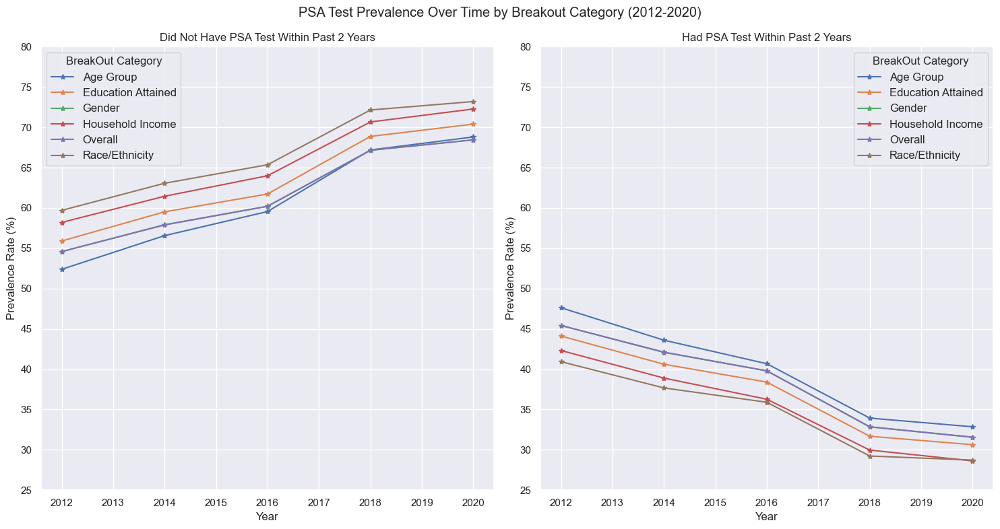

In [118]:
yes_data = data[data["Response"] == "Yes"]
no_data = data[data["Response"] == "No"]

trend_yes_data = yes_data.groupby(["Year", "Break_Out_Category"])["Data_value"].mean().reset_index()
trend_no_data = no_data.groupby(["Year", "Break_Out_Category"])["Data_value"].mean().reset_index()

plt.figure(figsize = [15,8])
plt.suptitle("PSA Test Prevalence Over Time by Breakout Category (2012-2020)")

plt.subplot(1,2,1)
for _ in trend_no_data["Break_Out_Category"].unique():
    plt.plot(trend_no_data["Year"].unique(), trend_no_data[trend_no_data["Break_Out_Category"] == _]["Data_value"], marker = "*", label = _)
plt.title("Did Not Have PSA Test Within Past 2 Years")
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(25,81,5))
plt.legend(title = "BreakOut Category", fontsize = 12)

plt.subplot(1,2,2)
for _ in trend_no_data["Break_Out_Category"].unique():
    plt.plot(trend_yes_data["Year"].unique(), trend_yes_data[trend_yes_data["Break_Out_Category"] == _]["Data_value"], marker = "*", label = _)
plt.title("Had PSA Test Within Past 2 Years")
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(25,81,5))
plt.legend(title = "BreakOut Category", fontsize = 12)

plt.tight_layout()
plt.show()

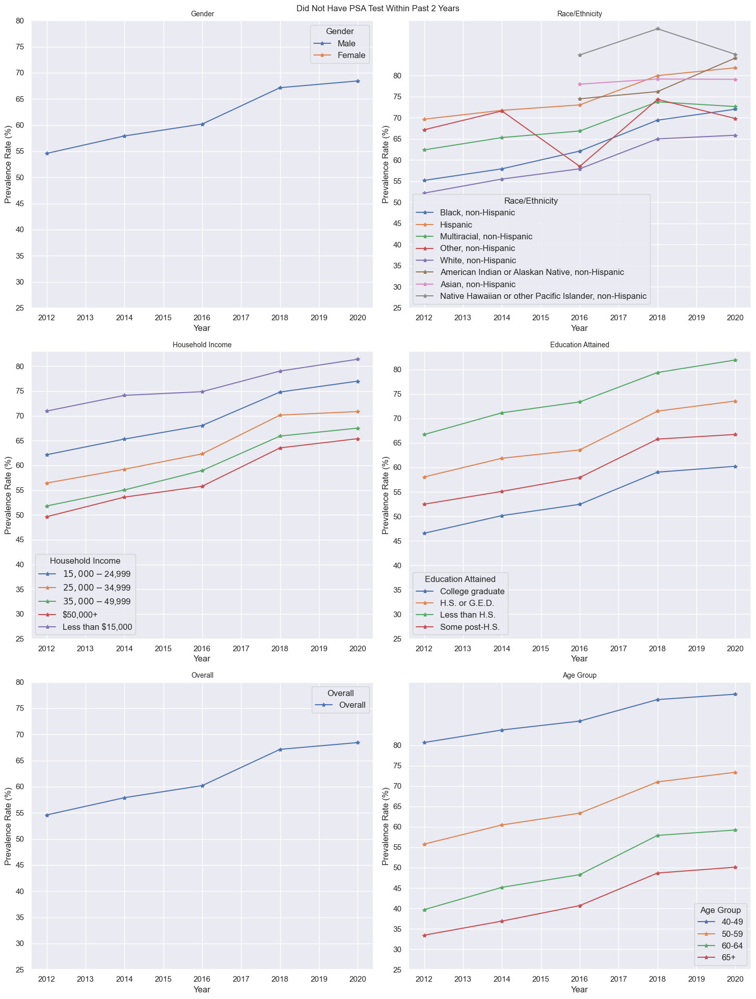

In [119]:
no_data = data[data["Response"] == "No"]

trend_no_data = no_data.groupby(["Year", "Break_Out_Category", "Break_Out"])["Data_value"].mean().reset_index()

fig, ax = plt.subplots(nrows = 3, ncols = 2, figsize = [15,20])
plt.suptitle("Did Not Have PSA Test Within Past 2 Years", fontsize = 12)

breakout_categories = list(data["Break_Out_Category"].unique())

ax = ax.flatten()

for _, val in enumerate(list(breakout_categories)):
    
    curr_no_data = trend_no_data[trend_no_data["Break_Out_Category"] == val]
    
    for i in curr_no_data["Break_Out"].unique():
        ax[_].plot(curr_no_data[curr_no_data["Break_Out"] == i]["Year"], curr_no_data[curr_no_data["Break_Out"] == i]["Data_value"], marker = "*", label = i)
    ax[_].set_title(val, fontsize = 10)
    ax[_].set_xlabel('Year')
    ax[_].set_ylabel('Prevalence Rate (%)')
    ax[_].set_yticks(range(25,81,5))
    ax[_].legend(title = val, fontsize = 12, loc = "best")

plt.tight_layout()
plt.show()

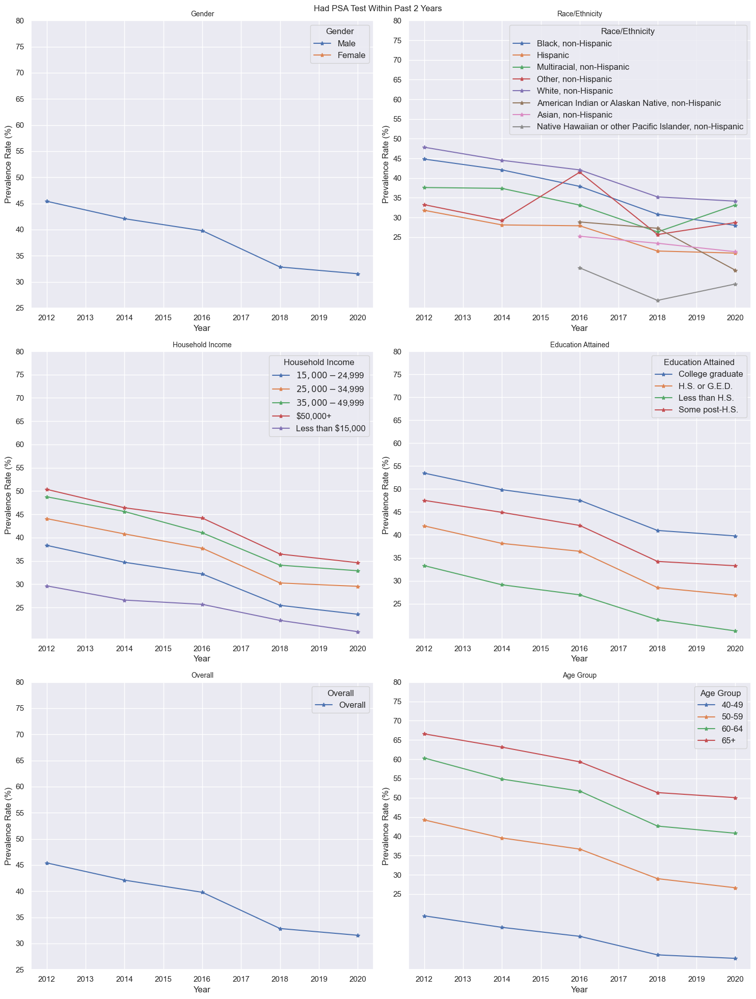

In [120]:
yes_data = data[data["Response"] == "Yes"]

trend_yes_data = yes_data.groupby(["Year", "Break_Out_Category", "Break_Out"])["Data_value"].mean().reset_index()

fig, ax = plt.subplots(nrows = 3, ncols = 2, figsize = [15,20])
plt.suptitle("Had PSA Test Within Past 2 Years", fontsize = 12)

breakout_categories = list(data["Break_Out_Category"].unique())

ax = ax.flatten()

for _, val in enumerate(list(breakout_categories)):

    curr_yes_data = trend_yes_data[trend_yes_data["Break_Out_Category"] == val]
        
    for i in curr_yes_data["Break_Out"].unique():
        ax[_].plot(curr_yes_data[curr_yes_data["Break_Out"] == i]["Year"], curr_yes_data[curr_yes_data["Break_Out"] == i]["Data_value"], marker = "*", label = i)
    ax[_].set_title(val, fontsize = 10)
    ax[_].set_xlabel('Year')
    ax[_].set_ylabel('Prevalence Rate (%)')
    ax[_].set_yticks(range(25,81,5))
    ax[_].legend(title = val, fontsize = 12, loc = "best")

plt.tight_layout()
plt.show()

**Geographical Analysis**

In [121]:
geo_yes_data = data[(data["Response"] == "Yes") & (data["Year"] == 2012)]

state_yes_data = geo_yes_data.groupby("Locationabbr")["Data_value"].mean().reset_index()

fig = px.choropleth(state_yes_data,
                    locations = "Locationabbr",
                    locationmode = "USA-states",
                    color = "Data_value",
                    scope = "usa",
                    color_continuous_scale = 'sunset',
                    title = 'PSA Test Prevalence by State (2012)')

fig.show()

In [122]:
geo_yes_data = data[(data["Response"] == "Yes") & (data["Year"] == 2014)]

state_yes_data = geo_yes_data.groupby("Locationabbr")["Data_value"].mean().reset_index()

fig = px.choropleth(state_yes_data,
                    locations = "Locationabbr",
                    locationmode = "USA-states",
                    color = "Data_value",
                    scope = "usa",
                    color_continuous_scale = 'sunset',
                    title = 'PSA Test Prevalence by State (2014)')

fig.show()

In [123]:
geo_yes_data = data[(data["Response"] == "Yes") & (data["Year"] == 2016)]

state_yes_data = geo_yes_data.groupby("Locationabbr")["Data_value"].mean().reset_index()

fig = px.choropleth(state_yes_data,
                    locations = "Locationabbr",
                    locationmode = "USA-states",
                    color = "Data_value",
                    scope = "usa",
                    color_continuous_scale = 'sunset',
                    title = 'PSA Test Prevalence by State (2016)')

fig.show()

In [124]:
geo_yes_data = data[(data["Response"] == "Yes") & (data["Year"] == 2018)]

state_yes_data = geo_yes_data.groupby("Locationabbr")["Data_value"].mean().reset_index()

fig = px.choropleth(state_yes_data,
                    locations = "Locationabbr",
                    locationmode = "USA-states",
                    color = "Data_value",
                    scope = "usa",
                    color_continuous_scale = 'sunset',
                    title = 'PSA Test Prevalence by State (2018)')

fig.show()

In [125]:
geo_yes_data = data[(data["Response"] == "Yes") & (data["Year"] == 2020)]

state_yes_data = geo_yes_data.groupby("Locationabbr")["Data_value"].mean().reset_index()

fig = px.choropleth(state_yes_data,
                    locations = "Locationabbr",
                    locationmode = "USA-states",
                    color = "Data_value",
                    scope = "usa",
                    color_continuous_scale = 'sunset',
                    title = 'PSA Test Prevalence by State (2020)')

fig.show()

**Confidence Interval Analysis**

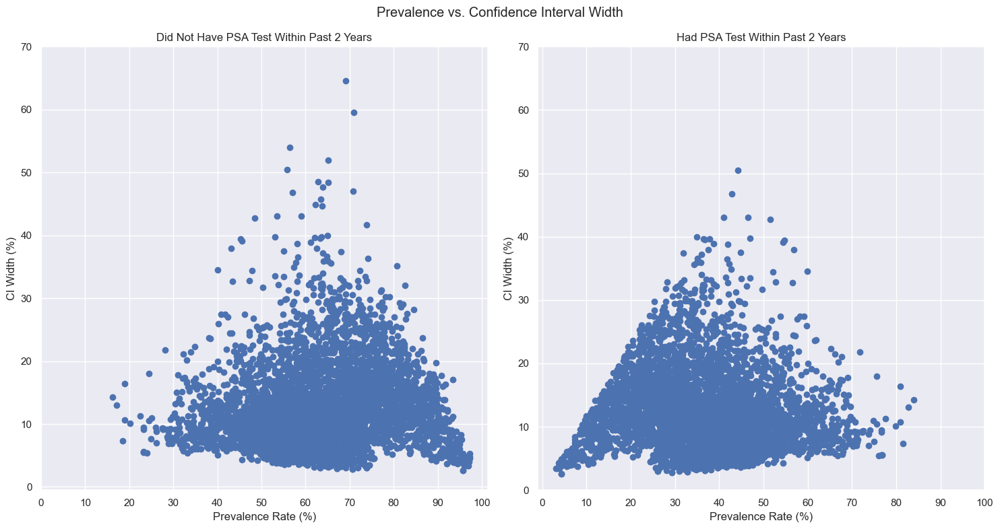

In [126]:
data["CI_Width"] = data["Confidence_limit_High"] - data["Confidence_limit_Low"]

ci_yes_data = data[data["Response"] == "Yes"]
ci_no_data = data[data["Response"] == "No"]

plt.figure(figsize = [15,8])
plt.suptitle('Prevalence vs. Confidence Interval Width')

plt.subplot(1,2,1)
plt.scatter(ci_no_data['Data_value'], ci_no_data['CI_Width'])
plt.title('Did Not Have PSA Test Within Past 2 Years')
plt.xlabel('Prevalence Rate (%)')
plt.ylabel('CI Width (%)')
plt.xticks(range(0,101,10))
plt.yticks(range(0,71, 10))

plt.subplot(1,2,2)
plt.scatter(ci_yes_data['Data_value'], ci_yes_data['CI_Width'])
plt.title('Had PSA Test Within Past 2 Years')
plt.xlabel('Prevalence Rate (%)')
plt.ylabel('CI Width (%)')
plt.xticks(range(0,101,10))
plt.yticks(range(0,71, 10))

plt.tight_layout()
plt.show()

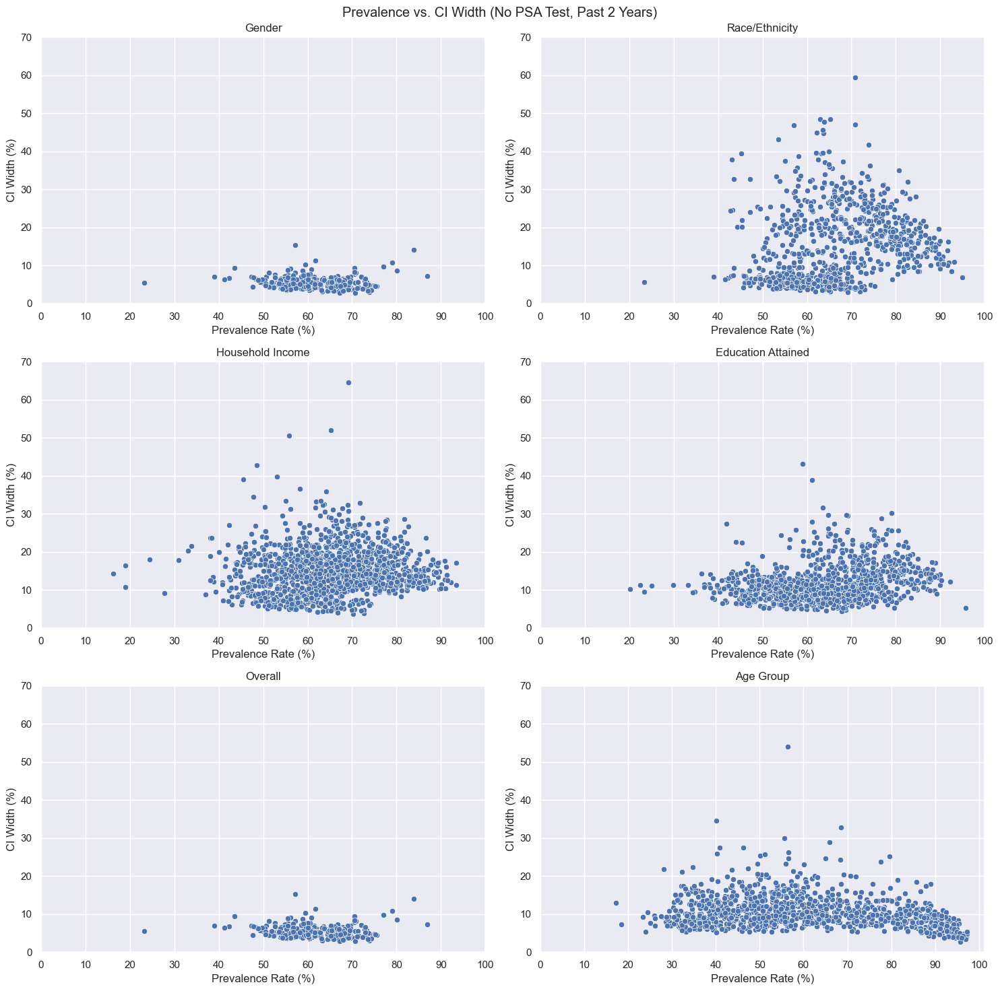

In [127]:
fig, ax = plt.subplots(nrows = 3, ncols = 2, figsize = [15,15])
plt.suptitle('Prevalence vs. CI Width (No PSA Test, Past 2 Years)')

ax = ax.flatten()

for idx, val in enumerate(list(data["Break_Out_Category"].unique())):
    sns.scatterplot(data = ci_no_data[ci_no_data["Break_Out_Category"] == val], x = "Data_value", y = "CI_Width", ax = ax[idx])
    ax[idx].set_title(val)
    ax[idx].set_xlabel('Prevalence Rate (%)')
    ax[idx].set_ylabel('CI Width (%)')
    ax[idx].set_xticks(range(0,101,10))
    ax[idx].set_yticks(range(0,71, 10))

plt.tight_layout()
plt.show()

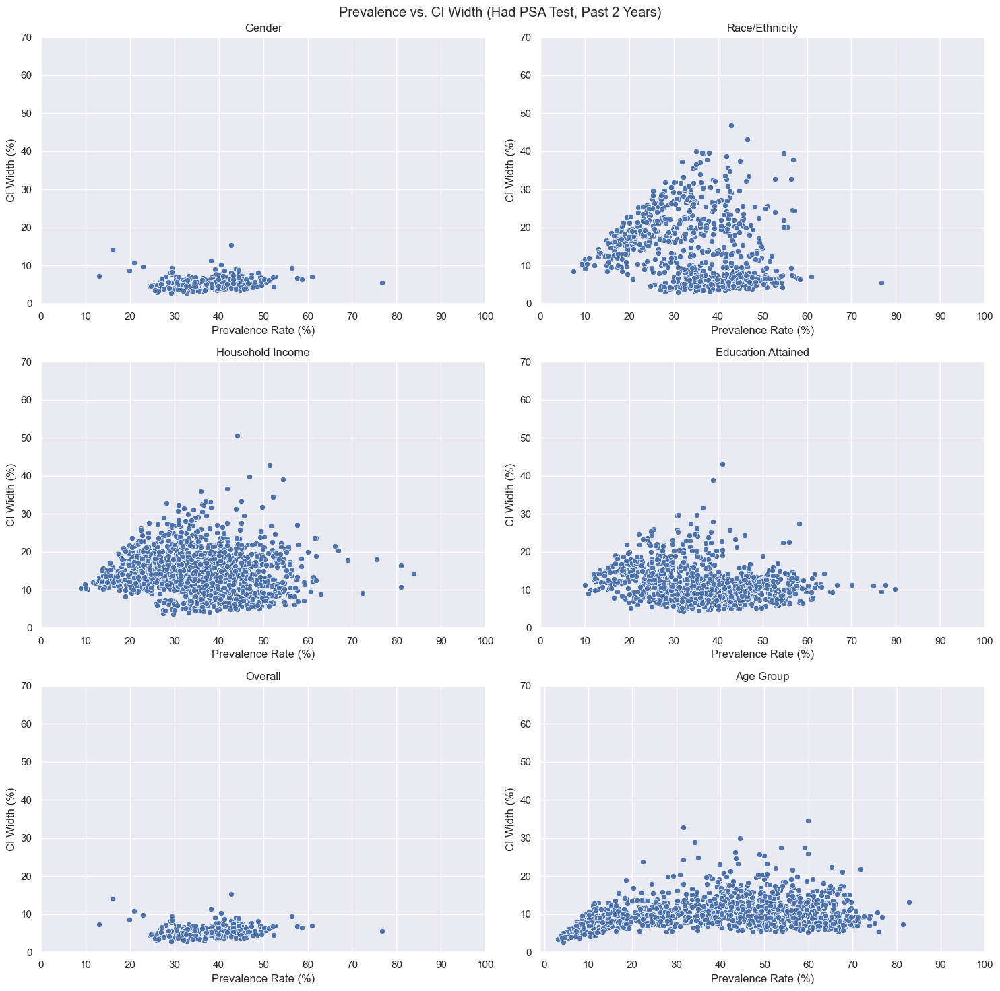

In [128]:
fig, ax = plt.subplots(nrows = 3, ncols = 2, figsize = [15,15])
plt.suptitle('Prevalence vs. CI Width (Had PSA Test, Past 2 Years)')

ax = ax.flatten()

for idx, val in enumerate(list(data["Break_Out_Category"].unique())):
    sns.scatterplot(data = ci_yes_data[ci_yes_data["Break_Out_Category"] == val], x = "Data_value", y = "CI_Width", ax = ax[idx])
    ax[idx].set_title(val)
    ax[idx].set_xlabel('Prevalence Rate (%)')
    ax[idx].set_ylabel('CI Width (%)')
    ax[idx].set_xticks(range(0,101,10))
    ax[idx].set_yticks(range(0,71, 10))

plt.tight_layout()
plt.show()

**Time Series Forecasting**

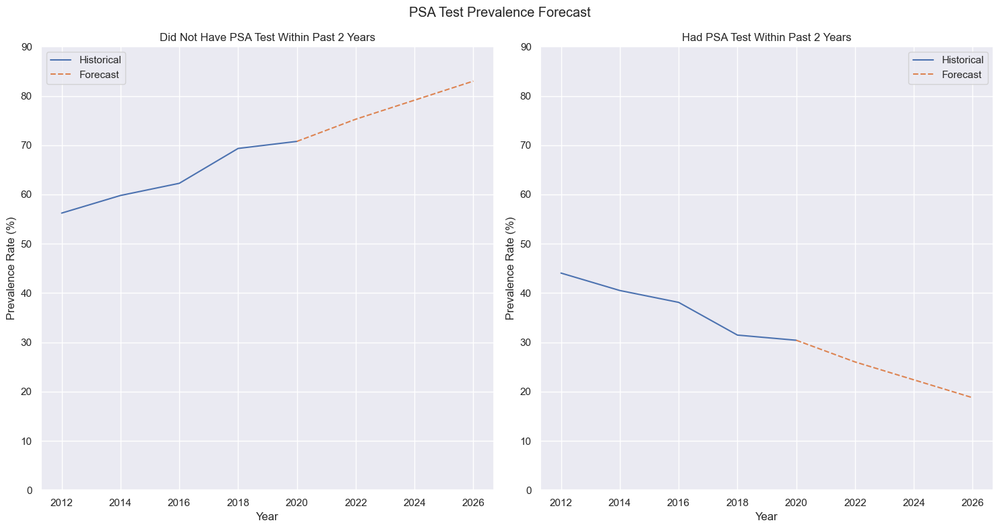

In [129]:
ts_no_data = data[data["Response"] == "No"].groupby("Year")["Data_value"].mean().reset_index()
ts_yes_data = data[data["Response"] == "Yes"].groupby("Year")["Data_value"].mean().reset_index()

model_no = ExponentialSmoothing(ts_no_data["Data_value"], trend = "add", seasonal = None)
fit_no = model_no.fit()
forecast_no = fit_no.forecast(3)

model_yes = ExponentialSmoothing(ts_yes_data["Data_value"], trend = "add", seasonal = None)
fit_yes = model_yes.fit()
forecast_yes = fit_yes.forecast(3)

plt.figure(figsize = [15,8])
plt.suptitle("PSA Test Prevalence Forecast")

plt.subplot(1,2,1)
plt.plot(ts_no_data["Year"], ts_no_data["Data_value"], label = "Historical")
plt.plot([2020, 2022, 2024, 2026], [ts_no_data["Data_value"].iloc[-1]] + forecast_no.to_list(), label = "Forecast", linestyle = "--")
plt.title('Did Not Have PSA Test Within Past 2 Years')
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(0,95, 10))
plt.legend()

plt.subplot(1,2,2)
plt.plot(ts_yes_data["Year"], ts_yes_data["Data_value"], label = "Historical")
plt.plot([2020, 2022, 2024, 2026], [ts_yes_data["Data_value"].iloc[-1]] + forecast_yes.to_list(), label = "Forecast", linestyle = "--")
plt.title('Had PSA Test Within Past 2 Years')
plt.xlabel('Year')
plt.ylabel('Prevalence Rate (%)')
plt.yticks(range(0,95, 10))
plt.legend()

plt.tight_layout()
plt.show()

**Cluster Analysis**

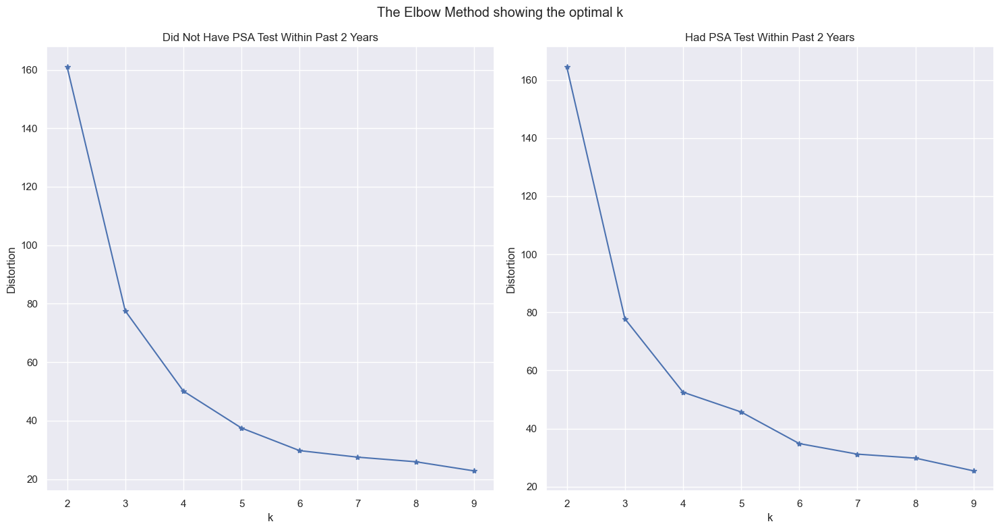

In [130]:
cluster_no_data = data[data["Response"] == "No"].pivot_table(values = "Data_value", columns = "Year", index = "Locationabbr", aggfunc = "mean").dropna()
cluster_yes_data = data[data["Response"] == "Yes"].pivot_table(values = "Data_value", columns = "Year", index = "Locationabbr", aggfunc = "mean").dropna()

scaler = StandardScaler()
scaled_no_data = scaler.fit_transform(cluster_no_data)
scaled_yes_data = scaler.fit_transform(cluster_yes_data)

distortions_no, distortions_yes, K = [], [], range(2, 10)
for k in K:
    kmeanModel_no, kmeanModel_yes = KMeans(n_clusters = k), KMeans(n_clusters = k)
    kmeanModel_no.fit(scaled_no_data)
    kmeanModel_yes.fit(scaled_yes_data)
    distortions_no.append(kmeanModel_no.inertia_)
    distortions_yes.append(kmeanModel_yes.inertia_)

plt.figure(figsize = [15,8])
plt.suptitle("The Elbow Method showing the optimal k")

plt.subplot(1,2,1)
plt.plot(K, distortions_no, marker = "*")
plt.title("Did Not Have PSA Test Within Past 2 Years")
plt.xlabel('k')
plt.ylabel('Distortion')

plt.subplot(1,2,2)
plt.plot(K, distortions_yes, marker = "*")
plt.title("Had PSA Test Within Past 2 Years")
plt.xlabel('k')
plt.ylabel('Distortion')

plt.tight_layout()
plt.show()

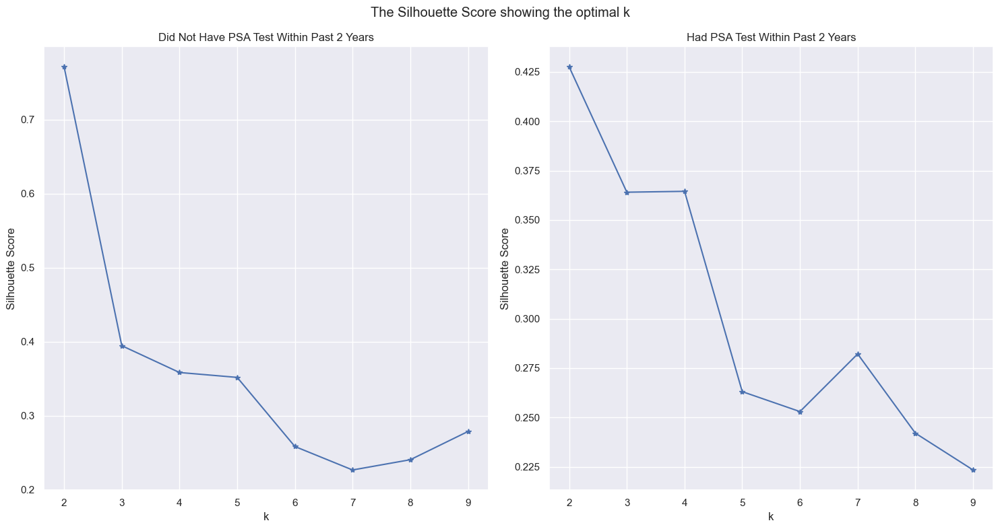

In [131]:
cluster_no_data = data[data["Response"] == "No"].pivot_table(values = "Data_value", columns = "Year", index = "Locationabbr", aggfunc = "mean").dropna()
cluster_yes_data = data[data["Response"] == "Yes"].pivot_table(values = "Data_value", columns = "Year", index = "Locationabbr", aggfunc = "mean").dropna()

scaler = StandardScaler()
scaled_no_data = scaler.fit_transform(cluster_no_data)
scaled_yes_data = scaler.fit_transform(cluster_yes_data)

silhouette_no, silhouette_yes, K = [], [], range(2, 10)
for k in K:
    kmeanModel_no, kmeanModel_yes = KMeans(n_clusters = k), KMeans(n_clusters = k)
    kmeanModel_no.fit(scaled_no_data)
    kmeanModel_yes.fit(scaled_yes_data)
    silhouette_no.append(silhouette_score(scaled_no_data,kmeanModel_no.labels_))
    silhouette_yes.append(silhouette_score(scaled_yes_data,kmeanModel_yes.labels_))

plt.figure(figsize = [15,8])
plt.suptitle("The Silhouette Score showing the optimal k")

plt.subplot(1,2,1)
plt.plot(K, silhouette_no, marker = "*")
plt.title("Did Not Have PSA Test Within Past 2 Years")
plt.xlabel('k')
plt.ylabel('Silhouette Score')

plt.subplot(1,2,2)
plt.plot(K, silhouette_yes, marker = "*")
plt.title("Had PSA Test Within Past 2 Years")
plt.xlabel('k')
plt.ylabel('Silhouette Score')

plt.tight_layout()
plt.show()

**Did Not Have PSA Test Within Past 2 Years**

In [68]:
kmeanModel_no = KMeans(n_clusters = 3, random_state = 45)
kmeanModel_no.fit(scaled_no_data)

KMeans(n_clusters=3, random_state=45)

In [75]:
cluster_no_data["Clusters"] = kmeanModel_no.labels_

In [76]:
print(f"Cluster 0 Minimum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 0].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 0 Maximum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 0].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 0 Minimum Prevalence Rate : 49.32
Cluster 0 Maximum Prevalence Rate : 74.17


In [77]:
print(f"Cluster 1 Minimum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 1].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 1 Maximum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 1].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 1 Minimum Prevalence Rate : 22.55
Cluster 1 Maximum Prevalence Rate : 77.56


In [78]:
print(f"Cluster 2 Minimum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 2].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 2 Maximum Prevalence Rate : {cluster_no_data[cluster_no_data['Clusters'] == 2].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 2 Minimum Prevalence Rate : 48.35
Cluster 2 Maximum Prevalence Rate : 85.38


In [79]:
cluster_no_data["Clusters"] = cluster_no_data["Clusters"].map({0 : "Low", 1 : "Moderate", 2 : "High"})
cluster_no_data["Clusters"] = pd.Categorical(cluster_no_data["Clusters"], categories = ["High", "Moderate", "Low"], ordered = True)
cluster_no_data = cluster_no_data.sort_values(by = "Clusters")

fig = px.choropleth(cluster_no_data,
                    locations = cluster_no_data.index,
                    locationmode = "USA-states",
                    color = "Clusters",
                    scope = "usa",
                    title = 'Regional Clustering of Non-Testing Prevalence (No PSA Test, Past 2 Years)')

fig.show()

**Had PSA Test Within Past 2 Years**

In [80]:
kmeanModel_yes = KMeans(n_clusters = 3, random_state = 45)
kmeanModel_yes.fit(scaled_yes_data)

KMeans(n_clusters=3, random_state=45)

In [81]:
cluster_yes_data["Clusters"] = kmeanModel_yes.labels_

In [82]:
print(f"Cluster 0 Minimum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 0].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 0 Maximum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 0].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 0 Minimum Prevalence Rate : 29.87
Cluster 0 Maximum Prevalence Rate : 77.46


In [83]:
print(f"Cluster 1 Minimum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 1].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 1 Maximum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 1].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 1 Minimum Prevalence Rate : 16.42
Cluster 1 Maximum Prevalence Rate : 41.12


In [84]:
print(f"Cluster 2 Minimum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 2].drop(columns = ['Clusters']).describe().T['min'].min():1.2f}")
print(f"Cluster 2 Maximum Prevalence Rate : {cluster_yes_data[cluster_yes_data['Clusters'] == 2].drop(columns = ['Clusters']).describe().T['max'].max():1.2f}")

Cluster 2 Minimum Prevalence Rate : 26.45
Cluster 2 Maximum Prevalence Rate : 50.69


In [85]:
cluster_yes_data["Clusters"] = cluster_yes_data["Clusters"].map({0 : "High", 1 : "Low", 2 : "Moderate"})
cluster_yes_data["Clusters"] = pd.Categorical(cluster_yes_data["Clusters"], categories = ["High", "Moderate", "Low"], ordered = True)
cluster_yes_data = cluster_yes_data.sort_values(by = "Clusters")

fig = px.choropleth(cluster_yes_data,
                    locations = cluster_yes_data.index,
                    locationmode = "USA-states",
                    color = "Clusters",
                    scope = "usa",
                    title = 'Regional Clustering of Testing Prevalence (PSA Test, Past 2 Years)')

fig.show()